# Episcanpy with OpenannotatePy

## 1.1 Preprocessing and clustering scATAC PBMCs

In [2]:
!mkdir data

In [ ]:
!wget https://www.dropbox.com/s/cwlaaxl70t27tb2/data_tutorial_buenrostro.tar.gz?dl=0 -O data/data_tutorial_buenrostro.tar.gz

In [ ]:
!cd data; tar -xzf data_tutorial_buenrostro.tar.gz

In [3]:
!mkdir write

mkdir: write: File exists


## Load libraries

In [4]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import episcanpy.api as epi

In [5]:
sc.settings.set_figure_params(dpi=80, color_map='gist_earth')

In [6]:
results_file = 'write/buenrostro_pbmc.h5ad'  # the file that will store the analysis results

## Load the data¶

In [8]:
adata = ad.read('data/data_tutorial_buenrostro/all_buenrostro_bulk_peaks.h5ad')
adata

AnnData object with n_obs × n_vars = 2034 × 491436
    obs: 'batch', 'cell_name'

In [9]:
adata

AnnData object with n_obs × n_vars = 2034 × 491436
    obs: 'batch', 'cell_name'

In [10]:
adata.X

<2034x491436 sparse matrix of type '<class 'numpy.float32'>'
	with 15206766 stored elements in Compressed Sparse Column format>

In [11]:
adata.obs

,batch,cell_name
BM1077-MPP-Frozen-160105-1.dedup.st.bam,0,BM1077-MPP-Frozen-160105-1
singles-20160726-scATAC-BM1137-GMP3high-HYC-88.dedup.st.bam,0,singles-20160726-scATAC-BM1137-GMP3high-HYC-88
singles-160808-scATAC-BM1137-GMP2mid-LS-65.dedup.st.bam,0,singles-160808-scATAC-BM1137-GMP2mid-LS-65
singles-BM0828-LMPP-frozen-151105-20.dedup.st.bam,0,singles-BM0828-LMPP-frozen-151105-20
singles-160819-BM1137-CMP-LS-95.dedup.st.bam,0,singles-160819-BM1137-CMP-LS-95
...,...,...
BM1077-LMPP-Frozen-160107-40.dedup.st.bam,1,BM1077-LMPP-Frozen-160107-40
BM1077-MPP-Frozen-160105-74.dedup.st.bam,1,BM1077-MPP-Frozen-160105-74
singles-BM1214-GMP-160421-9.dedup.st.bam,1,singles-BM1214-GMP-160421-9
singles-BM0828-LMPP-frozen-151105-62.dedup.st.bam,1,singles-BM0828-LMPP-frozen-151105-62


In [12]:
adata.obs['facs_label'] = ['MEP' if 'MEP' in line else line.split('.bam')[0].lstrip('singles-').split('BM')[-1].split('-')[1] for line in adata.obs['cell_name'].tolist()]
adata

AnnData object with n_obs × n_vars = 2034 × 491436
    obs: 'batch', 'cell_name', 'facs_label'

In [13]:
!head 'data/data_tutorial_buenrostro/metadata.tsv'

label	cell_type
BM1077-CLP-Frozen-160106-13	CLP
BM1077-CLP-Frozen-160106-14	CLP
BM1077-CLP-Frozen-160106-2	CLP
BM1077-CLP-Frozen-160106-21	CLP
BM1077-CLP-Frozen-160106-27	CLP
BM1077-CLP-Frozen-160106-3	CLP
BM1077-CLP-Frozen-160106-36	CLP
BM1077-CLP-Frozen-160106-42	CLP
BM1077-CLP-Frozen-160106-44	CLP


### Extract the FACs information from the file names

In [14]:
adata.obs['facs_label'] = ['MEP' if 'MEP' in line else line.split('.bam')[0].lstrip('singles-').split('BM')[-1].split('-')[1] for line in adata.obs['cell_name'].tolist()]
adata

AnnData object with n_obs × n_vars = 2034 × 491436
    obs: 'batch', 'cell_name', 'facs_label'

### Load the additional metadata¶


In [15]:
adata.obs_names = [x.split('/')[-1].split('.dedup.st.bam')[0] for x in adata.obs_names.tolist()]
adata.obs_names

Index(['BM1077-MPP-Frozen-160105-1',
       'singles-20160726-scATAC-BM1137-GMP3high-HYC-88',
       'singles-160808-scATAC-BM1137-GMP2mid-LS-65',
       'singles-BM0828-LMPP-frozen-151105-20',
       'singles-160819-BM1137-CMP-LS-95', 'BM1077-MPP-Frozen-160105-36',
       'singles-20160726-scATAC-BM1214-CMP-LS-84',
       'BM1077-CMP-Frozen-160106-21', 'singles-BM0106-HSC-SIM-160219-36',
       'singles-BM1214-GMP-160421-60',
       ...
       'singles-160822-BM1137-CMP-LS-91',
       'singles-BM0828-CMP-frozen-151118-69',
       'singles-20160617-scATAC-BM1214-CMP-LS-40',
       'singles-BM0828-GMP-151027-2',
       'singles-20160726-scATAC-BM1214-CMP-LS-19',
       'BM1077-LMPP-Frozen-160107-40', 'BM1077-MPP-Frozen-160105-74',
       'singles-BM1214-GMP-160421-9', 'singles-BM0828-LMPP-frozen-151105-62',
       'singles-BM0828-MEP-160420-43'],
      dtype='object', length=2034)

In [16]:
epi.pp.load_metadata(adata,
                     'data/data_tutorial_buenrostro/metadata.tsv',
                     separator='\t')
adata

AnnData object with n_obs × n_vars = 2034 × 491436
    obs: 'batch', 'cell_name', 'facs_label', 'label', 'cell_type'

In [17]:
pd.crosstab(adata.obs['cell_type'], adata.obs['facs_label'])

facs_label,CLP,CMP,GMP,GMP1low,GMP2mid,GMP3high,HSC,LMPP,MCP,MEP,MPP,UNK,mono,pDC
cell_type,,,,,,,,,,,,,,
CLP,78,0,0,0,0,0,0,0,0,0,0,0,0,0
CMP,0,502,0,0,0,0,0,0,0,0,0,0,0,0
GMP,0,0,216,68,44,74,0,0,0,0,0,0,0,0
HSC,0,0,0,0,0,0,347,0,0,0,0,0,0,0
LMPP,0,0,0,0,0,0,0,160,0,0,0,0,0,0
MEP,0,0,0,0,0,0,0,0,0,138,0,0,0,0
MPP,0,0,0,0,0,0,0,0,0,0,142,0,0,0
UNK,0,0,0,0,0,0,0,0,0,0,0,60,0,0
mono,0,0,0,0,0,0,0,0,0,0,0,0,64,0


## Load gene/transcript annotation

In [18]:
!wget ftp://ftp.ebi.ac.uk/pub/databases/gencode/Gencode_human/release_19/gencode.v19.annotation.gtf.gz -O data/data_tutorial_buenrostro/gencode.v19.annotation.gtf.gz

--2023-12-28 19:47:23--  ftp://ftp.ebi.ac.uk/pub/databases/gencode/Gencode_human/release_19/gencode.v19.annotation.gtf.gz
           => 'data/data_tutorial_buenrostro/gencode.v19.annotation.gtf.gz'
Resolving ftp.ebi.ac.uk (ftp.ebi.ac.uk)... 193.62.193.165
Connecting to ftp.ebi.ac.uk (ftp.ebi.ac.uk)|193.62.193.165|:21... connected.
Logging in as anonymous ... Logged in!
==> SYST ... done.    ==> PWD ... done.
==> TYPE I ... done.  ==> CWD (1) /pub/databases/gencode/Gencode_human/release_19 ... done.
==> SIZE gencode.v19.annotation.gtf.gz ... 37991892
==> PASV ... done.    ==> RETR gencode.v19.annotation.gtf.gz ... done.
Length: 37991892 (36M) (unauthoritative)

gencode.v19.annotat 100%[===================>]  36.23M   377KB/s    in 1m 42s  

2023-12-28 19:49:09 (364 KB/s) - 'data/data_tutorial_buenrostro/gencode.v19.annotation.gtf.gz' saved [37991892]



In [19]:
!cd data/data_tutorial_buenrostro; gunzip gencode.v19.annotation.gtf

In [20]:
epi.tl.find_genes(adata,
           gtf_file='data/data_tutorial_buenrostro/gencode.v19.annotation.gtf',
           key_added='transcript_annotation',
           upstream=2000,
           feature_type='transcript',
           annotation='HAVANA',
           raw=False)

## Preprocessing

In [21]:
print(np.max(adata.X))

1.0


In [22]:
epi.pp.filter_cells(adata, min_features=1)
epi.pp.filter_features(adata, min_cells=1)

### Quality controls

In [23]:
adata.obs['log_nb_features'] = [np.log10(x) for x in adata.obs['nb_features']]
adata

AnnData object with n_obs × n_vars = 2034 × 467226
    obs: 'batch', 'cell_name', 'facs_label', 'label', 'cell_type', 'nb_features', 'log_nb_features'
    var: 'transcript_annotation', 'n_cells'

... storing 'facs_label' as categorical
... storing 'cell_type' as categorical
... storing 'transcript_annotation' as categorical


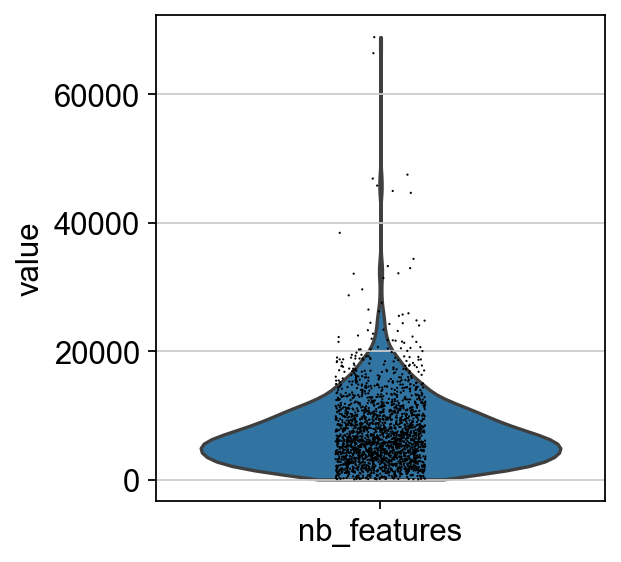

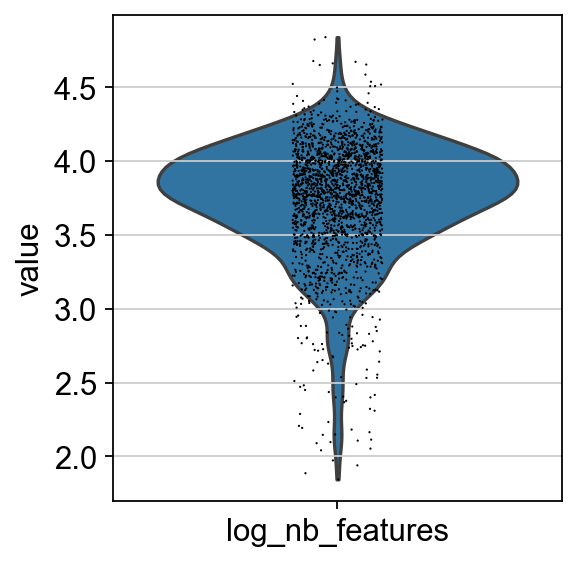

In [24]:
epi.pl.violin(adata, ['nb_features'])
epi.pl.violin(adata, ['log_nb_features'])

### Actually proceed to filter the cells and peaks based on the QC plots

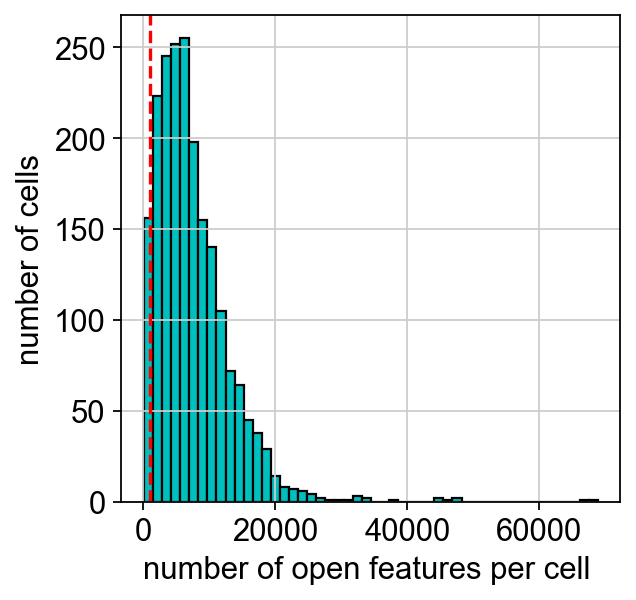

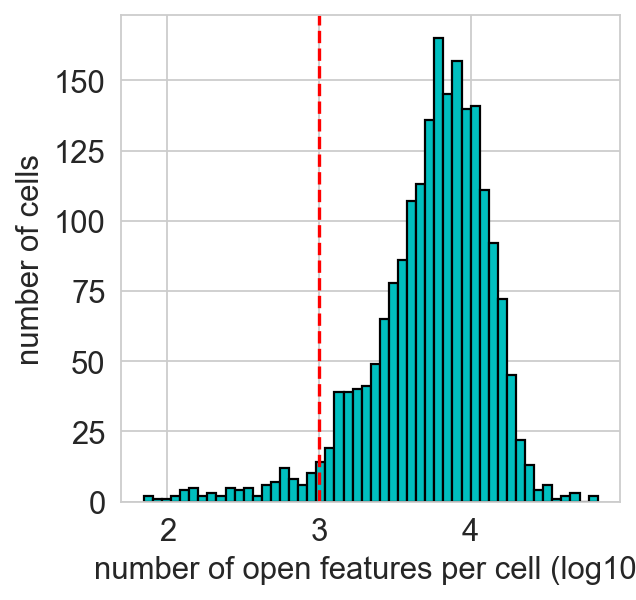

In [25]:
# set a minimum number of cells to keep 
min_features = 1000

epi.pp.coverage_cells(adata, binary=True, log=False, bins=50,
               threshold=min_features, save='Buenrostro_bulk_peaks_coverage_cells.png')
epi.pp.coverage_cells(adata, binary=True, log=10, bins=50,
               threshold=min_features, save='Buenrostro_bulk_peaks_coverage_cells_log10.png')

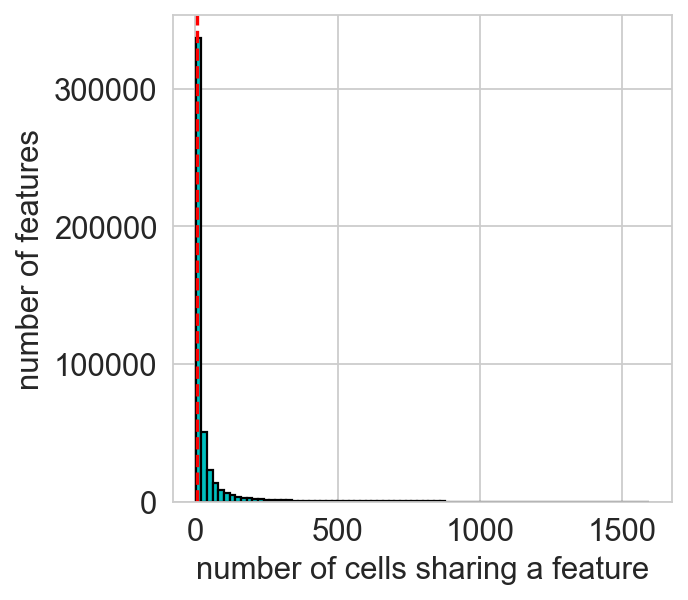

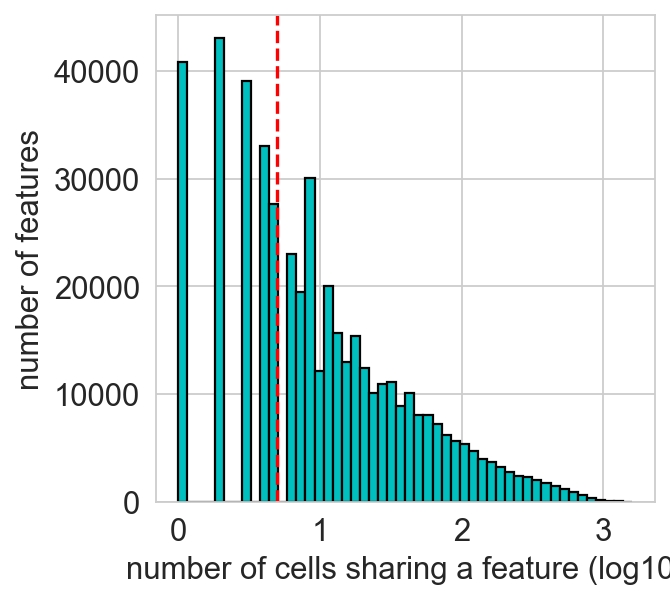

In [26]:
# minimum number of cells sharing a feature
min_cells = 5
epi.pp.coverage_features(adata, binary=True, log=False, 
                        threshold=min_cells, save='Buenrostro_bulk_peaks_coverage_peaks.png')
epi.pp.coverage_features(adata, binary=True, log=True, 
                        threshold=min_cells, save='Buenrostro_bulk_peaks_coverage_peaks_log10.png')

In [27]:
min_features = 1000
epi.pp.filter_cells(adata, min_features=min_features)
adata

AnnData object with n_obs × n_vars = 1945 × 467226
    obs: 'batch', 'cell_name', 'facs_label', 'label', 'cell_type', 'nb_features', 'log_nb_features'
    var: 'transcript_annotation', 'n_cells', 'commonness'

In [28]:
min_cells = 5
epi.pp.filter_features(adata, min_cells=min_cells)
adata

AnnData object with n_obs × n_vars = 1945 × 311035
    obs: 'batch', 'cell_name', 'facs_label', 'label', 'cell_type', 'nb_features', 'log_nb_features'
    var: 'transcript_annotation', 'n_cells', 'commonness'

###  Looking at the QC plots after filtering

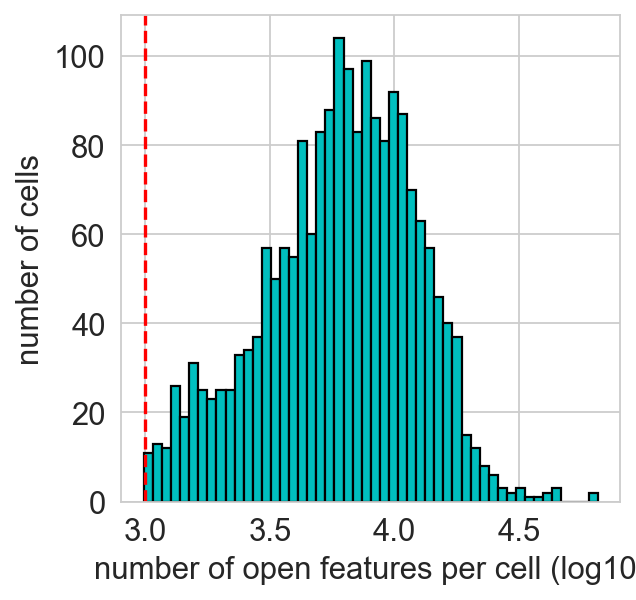

In [29]:
epi.pp.coverage_cells(adata, binary=True, log='log10', bins=50, threshold=min_features)

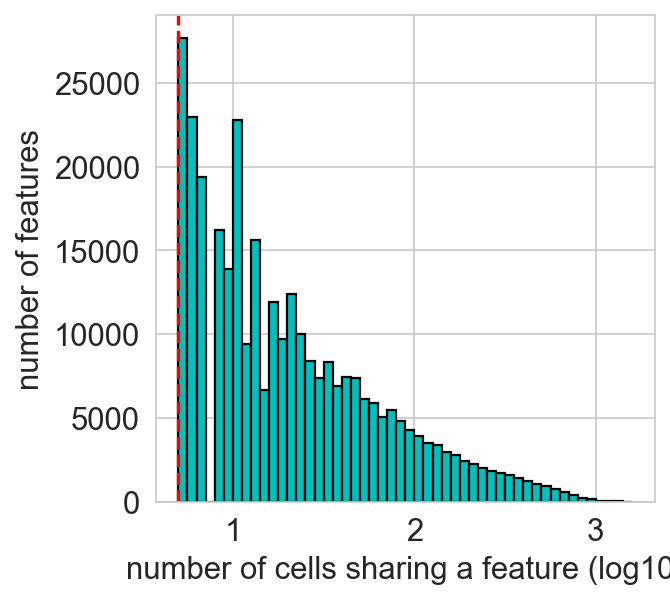

In [30]:
epi.pp.coverage_features(adata, binary=True, log='log10', bins=50, threshold=min_cells)

### Identifying the most variable features¶

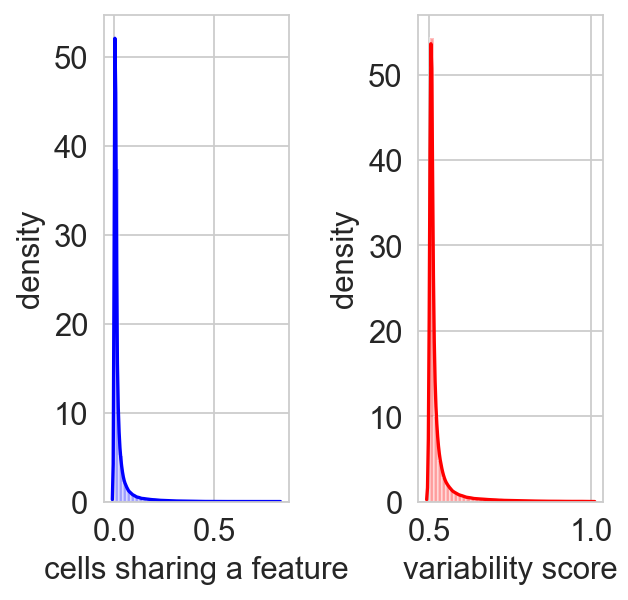

In [31]:
epi.pp.cal_var(adata)

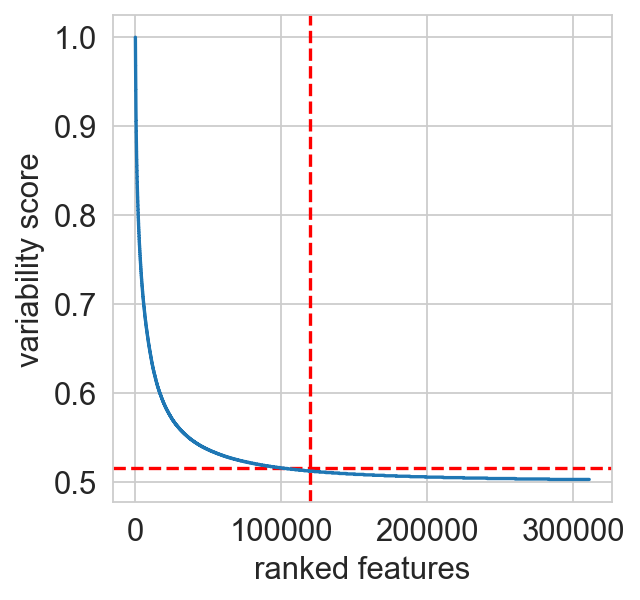

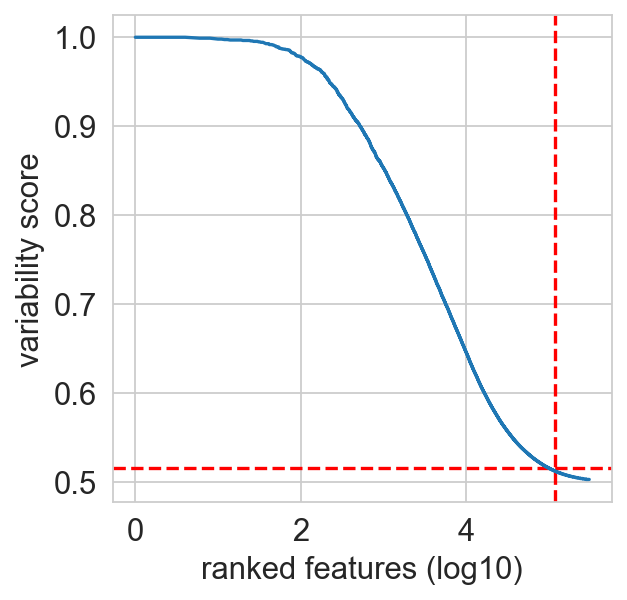

In [32]:
min_score_value = 0.515
nb_feature_selected = 120000
epi.pl.variability_features(adata,log=None,
                     min_score=min_score_value, nb_features=nb_feature_selected,
                     save='variability_features_plot_bonemarrow_peakmatrix.png')

epi.pl.variability_features(adata,log='log10',
                     min_score=min_score_value, nb_features=nb_feature_selected,
                     save='variability_features_plot_bonemarrow_peakmatrix_log10.png')

In [33]:
adata.raw = adata

In [34]:
adata = epi.pp.select_var_feature(adata,
                                  nb_features=nb_feature_selected,
                                  show=False,
                                  copy=True)

In [35]:
adata

View of AnnData object with n_obs × n_vars = 1945 × 122511
    obs: 'batch', 'cell_name', 'facs_label', 'label', 'cell_type', 'nb_features', 'log_nb_features'
    var: 'transcript_annotation', 'n_cells', 'commonness', 'prop_shared_cells', 'variability_score'

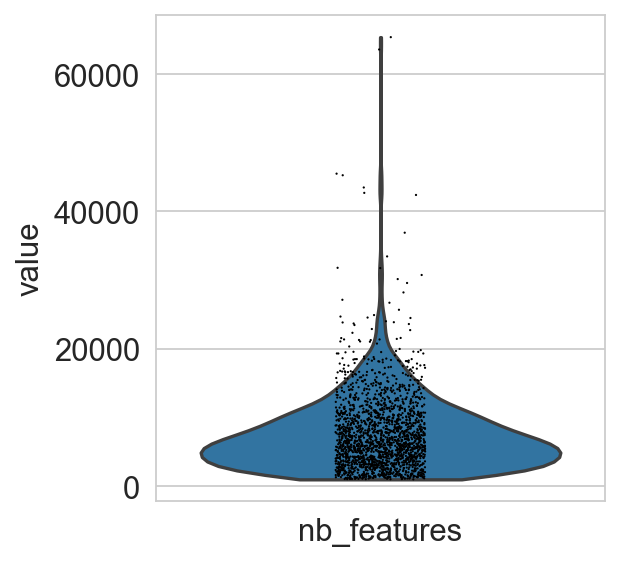

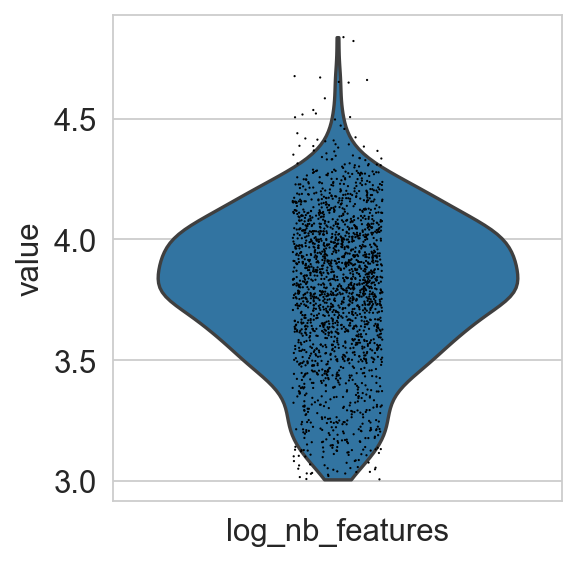

In [36]:
epi.pl.violin(adata, ['nb_features'])
epi.pl.violin(adata, ['log_nb_features'])

In [37]:
epi.pp.filter_cells(adata, min_features=2000)
epi.pp.filter_cells(adata, max_features=25000)

Trying to set attribute `.obs` of view, copying.


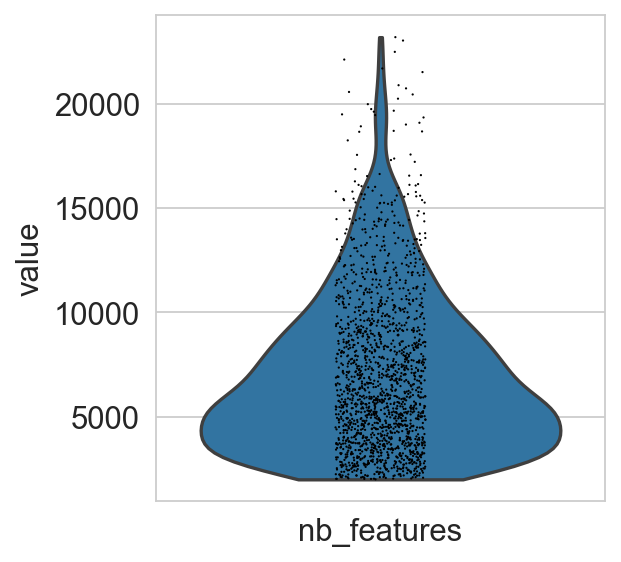

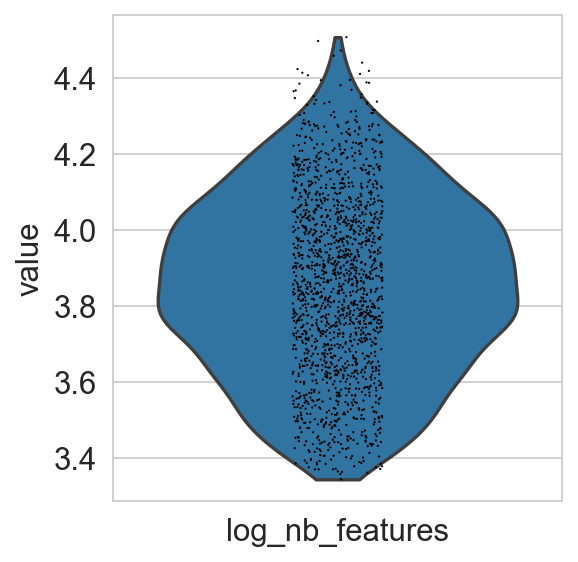

In [38]:
epi.pl.violin(adata, ['nb_features'])
epi.pl.violin(adata, ['log_nb_features'])

In [39]:
adata

AnnData object with n_obs × n_vars = 1722 × 122511
    obs: 'batch', 'cell_name', 'facs_label', 'label', 'cell_type', 'nb_features', 'log_nb_features'
    var: 'transcript_annotation', 'n_cells', 'commonness', 'prop_shared_cells', 'variability_score'

In [40]:
adata.obs['cell_name']

singles-20160726-scATAC-BM1137-GMP3high-HYC-88    singles-20160726-scATAC-BM1137-GMP3high-HYC-88
singles-160808-scATAC-BM1137-GMP2mid-LS-65            singles-160808-scATAC-BM1137-GMP2mid-LS-65
singles-160819-BM1137-CMP-LS-95                                  singles-160819-BM1137-CMP-LS-95
BM1077-MPP-Frozen-160105-36                                          BM1077-MPP-Frozen-160105-36
singles-20160726-scATAC-BM1214-CMP-LS-84                singles-20160726-scATAC-BM1214-CMP-LS-84
                                                                       ...                      
BM1077-LMPP-Frozen-160107-40                                        BM1077-LMPP-Frozen-160107-40
BM1077-MPP-Frozen-160105-74                                          BM1077-MPP-Frozen-160105-74
singles-BM1214-GMP-160421-9                                          singles-BM1214-GMP-160421-9
singles-BM0828-LMPP-frozen-151105-62                        singles-BM0828-LMPP-frozen-151105-62
singles-BM0828-MEP-160420-43  

In [41]:
adata_copy = adata

## Normalisation

#### Quick visualisation before normalisation

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


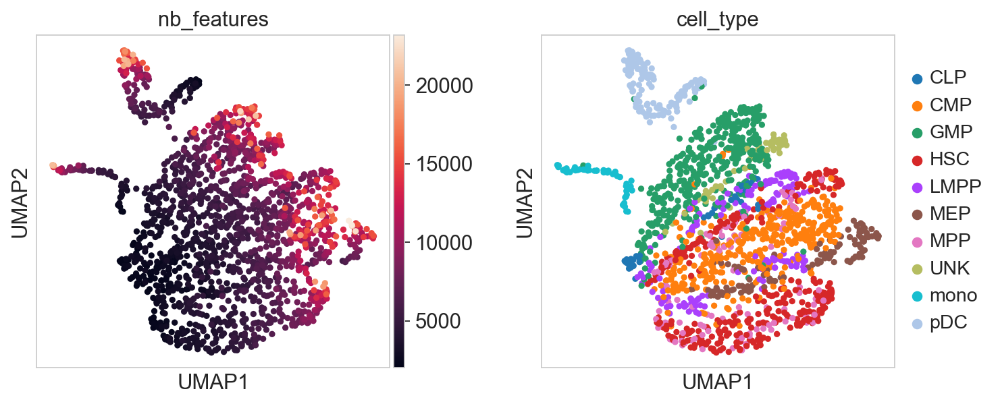

In [42]:
epi.pp.lazy(adata)
sc.pl.umap(adata, color=['nb_features', 'cell_type'], wspace=0.3)

## OpenAnnotatePy for reference data

### Extract genomic regions

In [43]:
regions = adata.var_names
regions = [i.split('_') for i in regions]
for region in regions:
    region.extend(['.','.','.'])

In [44]:
filename = 'episcanpy.bed'
with open (filename,'w') as file_object:
    for line in regions:
        file_object.write('\t'.join(line) + "\n")   

### Load OpenAnnotatePy and submit annotation jobs

In [45]:
from OpenAnnotatePy import OpenAnnotateApi

In [46]:
oaa=OpenAnnotateApi.Annotate()

Use object.help() to get basic functions and arguments


In [47]:
oaa.SetAddress('159.226.47.242','65533')

In [48]:
oaa.setParams(species = 1, protocol=1, cell_type=1, perbase=1)

Species:  GRCh37/hg19
Protocol:  DNase-seq(ENCODE)
Cell type: 
All biosamples
Annotate mode:  region based


In [49]:
file_path = './episcanpy.bed'
task_id=oaa.runAnnotate(file_path)

Uploading...
Initializing...
Your task id is: 2023122819518755
You can get the progress of your task through object.getProgress(task_id=2023122819518755)


In [50]:
oaa.getProgress(task_id)

Your task has been completed!
You can get the result file type first through object.getResultType()
You can download result file through data = object.getAnnoResult(result_type, 2023122819518755 , cell_type)


In [51]:
# download readopen file
oaa.getAnnoResult(2,task_id,1)

Get the result to ./results/readopen_2023122819518755.txt


[['chr1',
  '13252',
  '13752',
  '.',
  '0',
  '0',
  '0.08194',
  '0',
  '0.1128',
  '0.1012',
  '0.1755',
  '0',
  '0.1276',
  '0',
  '0',
  '0.1875',
  '0',
  '0.4747',
  '0',
  '0',
  '0',
  '0.1396',
  '0.6078',
  '0',
  '0',
  '0.3159',
  '0.3411',
  '0.3799',
  '0',
  '0',
  '0.1108',
  '0.768',
  '0.1827',
  '0',
  '0',
  '0.1758',
  '0.04158',
  '0.04146',
  '0',
  '0',
  '0',
  '0',
  '0.4264',
  '0.4244',
  '0.08254',
  '0.07798',
  '0',
  '0.06416',
  '0.04557',
  '0.02353',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0',
  '0.1033',
  '0',
  '0',
  '0.1033',
  '0.1426',
  '0.1643',
  '0.1545',
  '0.04492',
  '0.08193',
  '0.1628',
  '0.0918',
  '0.06041',
  '0.2104',
  '0.1045',
  '0.03004',
  '0.1558',
  '0.1356',
  '0.06877',
  '0.1865',
  '0.1661',
  '0',
  '0.2389',
  '0.2391',
  '0',
  '0.01429',
  '0.03875',
  '0.06722',
  '0',
  '0.01428',
  '0.05494',
  '0',
  '0.4059',
  '0.05504',
  '0',
  '0.5027',
  '0.2209',
  '0.07437',
  '0.07852',
  '0.09782',
  '0.2314',
  '0.2

In [52]:
readopen = np.loadtxt('./results/readopen_2023122819518755.txt',dtype = str)
readopen = readopen[:,4:].astype(float)

### readopen as reference

In [54]:
from sklearn.decomposition import PCA
import umap
# Perform TF-IDF
def TFIDF(sc_counts):
    nfreqs = 1.0 * sc_counts / np.tile(np.sum(sc_counts,axis=0)+ 1e-10, (sc_counts.shape[0],1)) 
    sc_tfidf  = nfreqs * np.tile(np.log(1 + 1.0 * sc_counts.shape[1] / np.sum(sc_counts+1e-10,axis=1)+ 1).reshape(-1,1), (1,sc_counts.shape[1]))
    return sc_tfidf
ref_pca = PCA(svd_solver='arpack', random_state=0,n_components = 50).fit(TFIDF(readopen.T))

In [55]:
sc_counts = adata.X.toarray()

In [56]:
sc_counts = sc_counts.T
# Perform TF-IDF
nfreqs = 1.0 * sc_counts / np.tile(np.sum(sc_counts,axis=0), (sc_counts.shape[0],1))
sc_tfidf  = nfreqs * np.tile(np.log(1 + 1.0 * sc_counts.shape[1] / np.sum(sc_counts,axis=1)).reshape(-1,1), (1,sc_counts.shape[1]))

In [57]:
sc_tfidf.shape

(122511, 1722)

In [58]:
sc_tfidf_refProj = ref_pca.transform(sc_tfidf.T)

In [59]:
temp_pca = adata.obsm['X_pca'].copy()
adata.obsm['X_pca'] = np.hstack((sc_tfidf_refProj,temp_pca))

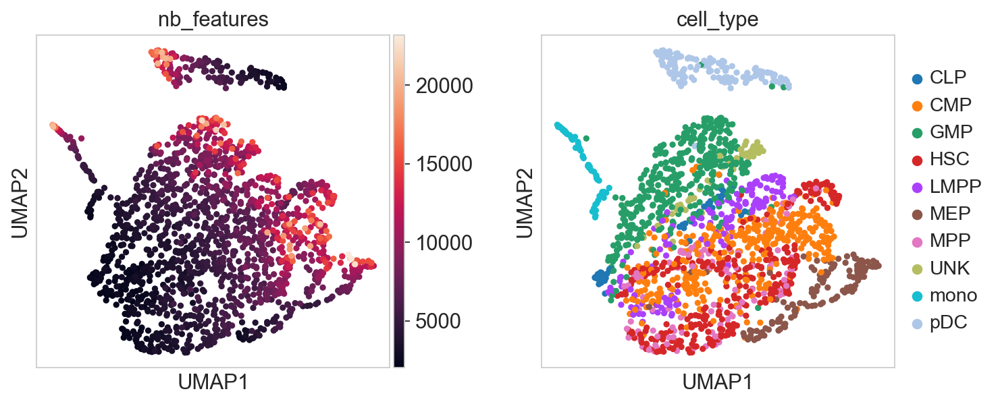

In [60]:
epi.pp.lazy(adata,pp_pca=False,nb_pcs=100)
sc.pl.umap(adata, color=['nb_features', 'cell_type'], wspace=0.3)